In [1]:
import numpy as np
import cv2 as cv
import os
import matplotlib.pyplot as plt
import torch

from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torch import nn
from torch.nn import functional as F
from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torchvision import transforms as T
from torchvision.utils import make_grid

# Dataset

In [2]:
class AnimeFacesDataset(Dataset):
    def __init__(self, root_dir, transform = None):
        super().__init__()
        self.root_dir = root_dir
        self.img_filename_list = []
        for i in os.listdir(root_dir):
            if i.endswith('.png') or i.endswith('.jpg') or i.endswith('.jpeg'):
                self.img_filename_list.append(i)
        self.transform = transform
        
    def __len__(self):
        return len(self.img_filename_list)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.img_filename_list[idx])
#         print(img_path)
        img = Image.open(img_path)
        
        if self.transform:
            img = self.transform(img)
        
        return img
        

# GAN Model

In [3]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)  # Khởi tạo trọng số của Conv layer theo phương pháp Gaussian
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)  # Khởi tạo trọng số của BatchNorm layer theo phương pháp Gaussian
        nn.init.constant_(m.bias.data, 0)  # Đặt bias của BatchNorm layer về 0

In [4]:
def ConvLayer(in_channels, out_channels, kernel_size = 4, stride = 2, padding = 1):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size = kernel_size, stride = stride, padding = padding, bias = False),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.2, inplace = True),
        nn.Dropout(p=0.2, inplace=False)
    )

def DeConvLayer(in_channels, out_channels, kernel_size = 4, stride = 2, padding = 1):
    return nn.Sequential(
        nn.ConvTranspose2d(in_channels, out_channels, kernel_size = kernel_size, stride = stride, padding = padding, bias = False),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(inplace = True)
    )


In [5]:
class GeneratorModel(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        
        self.model = nn.Sequential(
            DeConvLayer(in_channels, hidden_channels, 4, 2, 0),
            DeConvLayer(hidden_channels, hidden_channels // 2, 4, 2, 1),
            DeConvLayer(hidden_channels//2, hidden_channels // 4, 4, 2, 1),
            DeConvLayer(hidden_channels // 4, hidden_channels // 8, 4, 2, 1),
            nn.ConvTranspose2d(hidden_channels // 8, out_channels, 4, 2, 1, bias = False),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)


In [6]:
class DiscriminatorModel(nn.Module):
    def __init__(self, in_channels, step_channels = 64):
        super().__init__()
        self.model = nn.Sequential(
            ConvLayer(in_channels, step_channels, 4, 2, 1),
            ConvLayer(step_channels, step_channels * 2, 4, 2, 1),
            ConvLayer(step_channels * 2, step_channels * 4, 4, 2, 1),
            ConvLayer(step_channels * 4, step_channels * 8, 4, 2, 1),
            nn.Conv2d(step_channels * 8, 1, kernel_size = 4, stride = 1, padding = 0, bias = False),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.model(x)
    

# Parameters

In [11]:
root_dir = '/kaggle/input/anime-faces/data'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
img_size = 64
batch_size = 512
num_workers = os.cpu_count()

real_label = 1.
fake_label = 0.

lr = 0.0002
beta1 = 0.5 


# DataLoader

In [12]:
transform = T.Compose(
    [
        T.Resize(img_size),
        T.ToTensor(),
#         T.Normalize(mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225]),
    ]
)

train_dataset = AnimeFacesDataset(root_dir, transform)
train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = True, num_workers = num_workers, drop_last = True)


# Models

In [13]:
Gen_in_channels = 100
Gen_hidden_channels = 512
Gen_out_channels = Dis_in_channels = 3
step_channels = 64
gen_model = GeneratorModel(Gen_in_channels, Gen_hidden_channels, Gen_out_channels).to(device)
dis_model = DiscriminatorModel(Dis_in_channels, step_channels).to(device)

gen_model.apply(weights_init)
dis_model.apply(weights_init)

optim_D = Adam(dis_model.parameters(), lr=lr, betas=(beta1, 0.999))
optim_G = Adam(gen_model.parameters(), lr=lr, betas=(beta1, 0.999))

criterion = nn.BCELoss()

# Gen_scheduler = ReduceLROnPlateau(optim_G, mode = 'min', factor = 0.1, patience = 3)
# Dis_scheduler = ReduceLROnPlateau(optim_D, mode = 'min', factor = 0.1, patience = 3)

# Train Model

Epoch 1/100: 100%|██████████████████████████████████████████████████| 42/42 [01:39<00:00,  2.38s/it]


Loss D:  0.9005, Loss G: 8.1431, D(x):  0.7359, D(G(z)) :  0.0002/ 0.0008


Epoch 2/100: 100%|██████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  1.1516, Loss G: 5.3686, D(x):  0.6059, D(G(z)) :  0.0416/ 0.0121


Epoch 3/100: 100%|██████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.21it/s]


Loss D:  0.9813, Loss G: 5.6298, D(x):  0.7101, D(G(z)) :  0.1923/ 0.0088


Epoch 4/100: 100%|██████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  1.0057, Loss G: 5.3740, D(x):  0.7838, D(G(z)) :  0.3347/ 0.0110


Epoch 5/100: 100%|██████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  1.1429, Loss G: 3.6083, D(x):  0.5771, D(G(z)) :  0.0877/ 0.0523


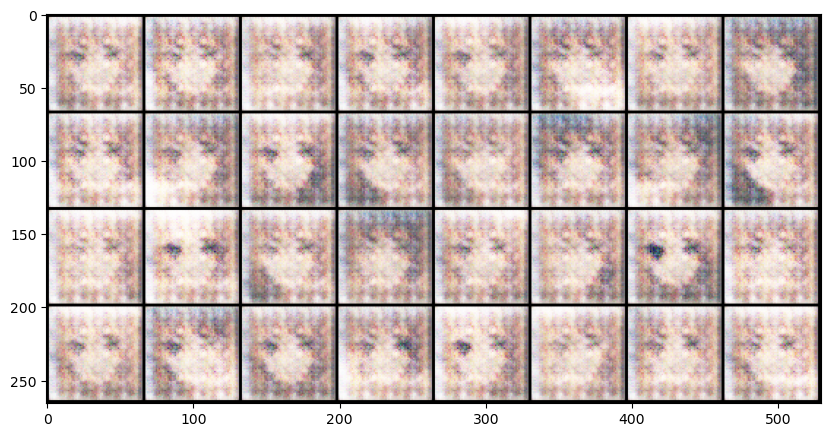

Epoch 6/100: 100%|██████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.22it/s]


Loss D:  0.9298, Loss G: 5.3581, D(x):  0.8537, D(G(z)) :  0.3588/ 0.0100


Epoch 7/100: 100%|██████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.19it/s]


Loss D:  1.9597, Loss G: 7.3978, D(x):  0.8542, D(G(z)) :  0.6876/ 0.0023


Epoch 8/100: 100%|██████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  1.4948, Loss G: 6.1192, D(x):  0.9109, D(G(z)) :  0.6088/ 0.0049


Epoch 9/100: 100%|██████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.25it/s]


Loss D:  0.7545, Loss G: 3.8107, D(x):  0.7739, D(G(z)) :  0.2284/ 0.0503


Epoch 10/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.20it/s]


Loss D:  0.8116, Loss G: 3.6615, D(x):  0.6971, D(G(z)) :  0.1777/ 0.0453


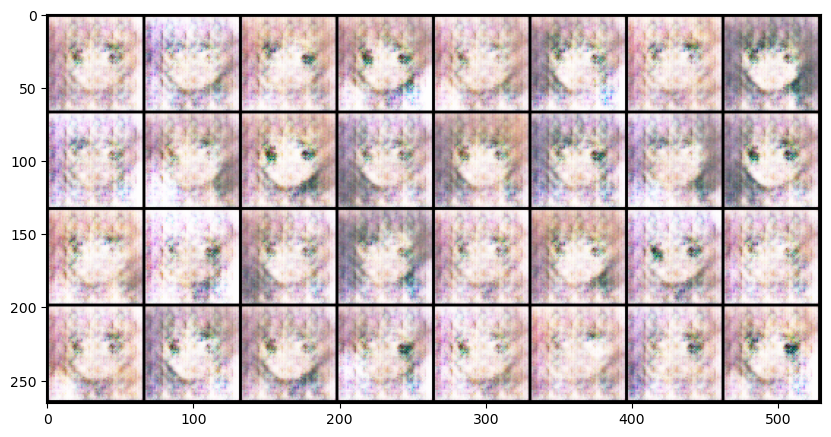

Epoch 11/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.12it/s]


Loss D:  0.9428, Loss G: 4.1727, D(x):  0.7286, D(G(z)) :  0.2923/ 0.0293


Epoch 12/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.22it/s]


Loss D:  1.0173, Loss G: 5.8656, D(x):  0.7240, D(G(z)) :  0.3260/ 0.0051


Epoch 13/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  0.9334, Loss G: 4.7589, D(x):  0.8230, D(G(z)) :  0.3740/ 0.0133


Epoch 14/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.8866, Loss G: 3.2415, D(x):  0.6532, D(G(z)) :  0.1826/ 0.0641


Epoch 15/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.21it/s]


Loss D:  0.7554, Loss G: 3.8380, D(x):  0.7882, D(G(z)) :  0.2514/ 0.0309


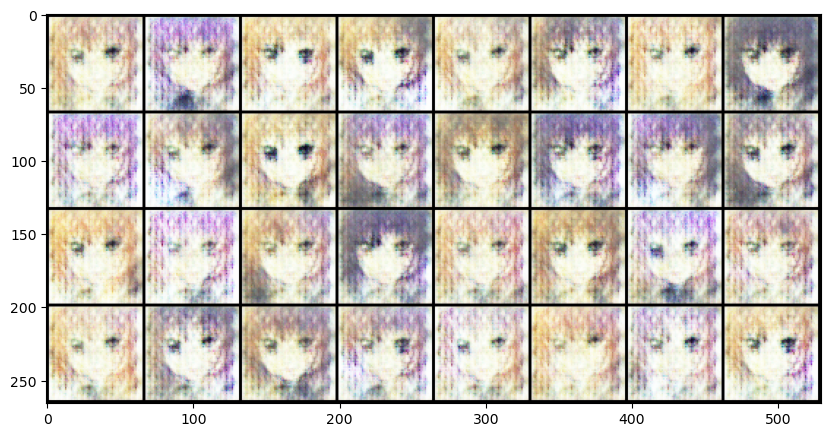

Epoch 16/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.20it/s]


Loss D:  0.6605, Loss G: 3.3541, D(x):  0.8340, D(G(z)) :  0.2138/ 0.0632


Epoch 17/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.07it/s]


Loss D:  0.9421, Loss G: 4.2635, D(x):  0.7832, D(G(z)) :  0.3660/ 0.0248


Epoch 18/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  1.0974, Loss G: 5.1063, D(x):  0.8667, D(G(z)) :  0.4833/ 0.0097


Epoch 19/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  1.3763, Loss G: 2.5361, D(x):  0.3962, D(G(z)) :  0.0299/ 0.1124


Epoch 20/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.10it/s]


Loss D:  1.5960, Loss G: 2.5208, D(x):  0.3374, D(G(z)) :  0.0129/ 0.1311


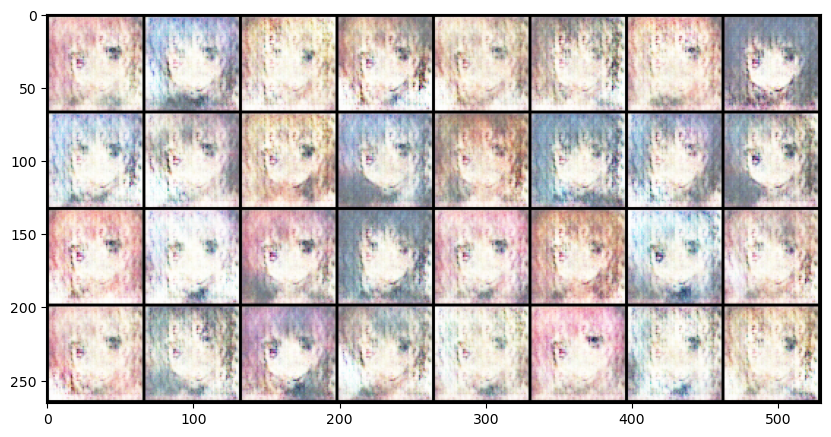

Epoch 21/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.19it/s]


Loss D:  0.9094, Loss G: 2.7023, D(x):  0.6203, D(G(z)) :  0.1827/ 0.0983


Epoch 22/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.8963, Loss G: 3.1090, D(x):  0.6191, D(G(z)) :  0.1308/ 0.0693


Epoch 23/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.08it/s]


Loss D:  1.4360, Loss G: 6.1146, D(x):  0.8537, D(G(z)) :  0.6198/ 0.0038


Epoch 24/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.21it/s]


Loss D:  0.6989, Loss G: 3.4246, D(x):  0.7031, D(G(z)) :  0.1246/ 0.0530


Epoch 25/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.8064, Loss G: 3.2521, D(x):  0.6225, D(G(z)) :  0.0694/ 0.0613


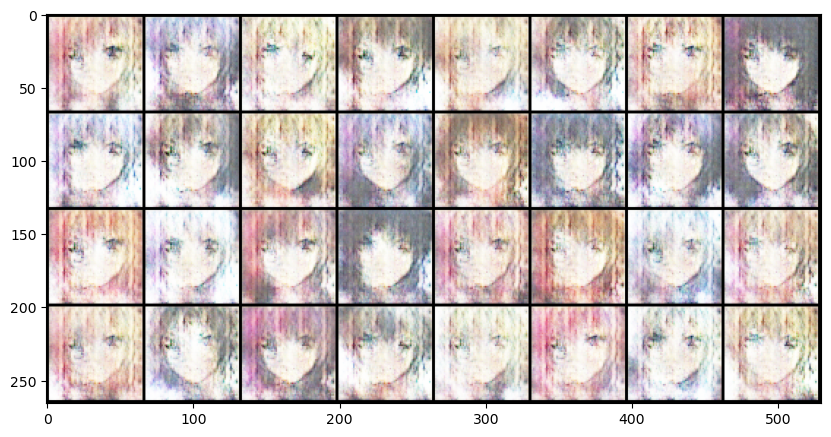

Epoch 26/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.7953, Loss G: 3.7467, D(x):  0.7399, D(G(z)) :  0.2321/ 0.0375


Epoch 27/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.25it/s]


Loss D:  0.7841, Loss G: 4.3151, D(x):  0.8750, D(G(z)) :  0.3326/ 0.0201


Epoch 28/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.16it/s]


Loss D:  0.7190, Loss G: 3.3447, D(x):  0.6999, D(G(z)) :  0.1338/ 0.0577


Epoch 29/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.16it/s]


Loss D:  0.6849, Loss G: 3.2883, D(x):  0.7099, D(G(z)) :  0.1186/ 0.0578


Epoch 30/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.16it/s]


Loss D:  0.7279, Loss G: 5.2987, D(x):  0.8432, D(G(z)) :  0.2753/ 0.0079


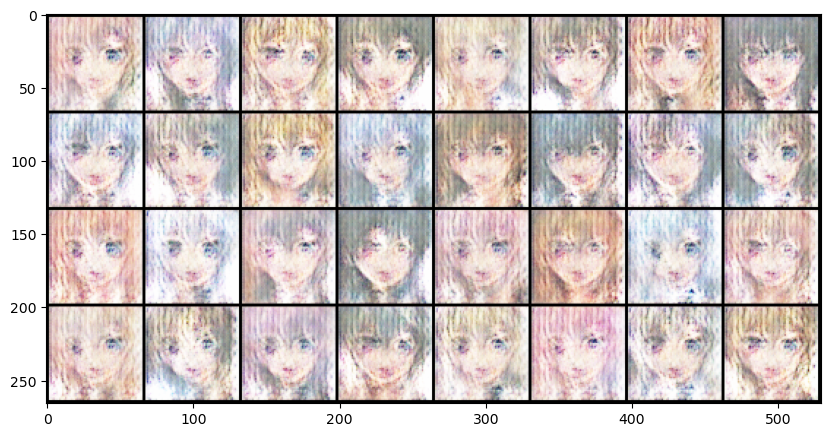

Epoch 31/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.7265, Loss G: 4.9290, D(x):  0.6506, D(G(z)) :  0.0181/ 0.0137


Epoch 32/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.20it/s]


Loss D:  1.2598, Loss G: 5.8595, D(x):  0.9212, D(G(z)) :  0.5547/ 0.0049


Epoch 33/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.7022, Loss G: 4.5877, D(x):  0.8253, D(G(z)) :  0.2435/ 0.0188


Epoch 34/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.11it/s]


Loss D:  0.6651, Loss G: 2.9946, D(x):  0.7219, D(G(z)) :  0.1277/ 0.0746


Epoch 35/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.08it/s]


Loss D:  0.7138, Loss G: 3.1700, D(x):  0.7239, D(G(z)) :  0.1698/ 0.0660


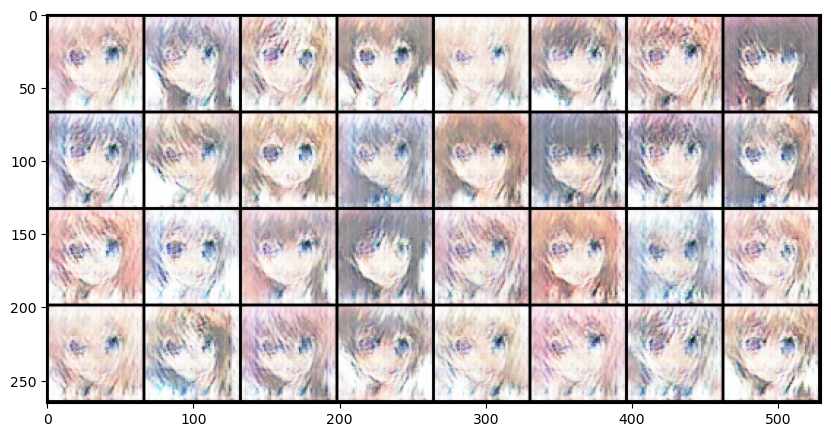

Epoch 36/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.08it/s]


Loss D:  0.5975, Loss G: 4.2795, D(x):  0.8331, D(G(z)) :  0.1763/ 0.0268


Epoch 37/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.6999, Loss G: 3.8868, D(x):  0.7867, D(G(z)) :  0.2127/ 0.0350


Epoch 38/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.09it/s]


Loss D:  0.6858, Loss G: 3.7784, D(x):  0.7500, D(G(z)) :  0.1644/ 0.0391


Epoch 39/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  0.7960, Loss G: 2.2464, D(x):  0.6429, D(G(z)) :  0.1131/ 0.1549


Epoch 40/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  0.5707, Loss G: 3.5784, D(x):  0.8199, D(G(z)) :  0.1455/ 0.0450


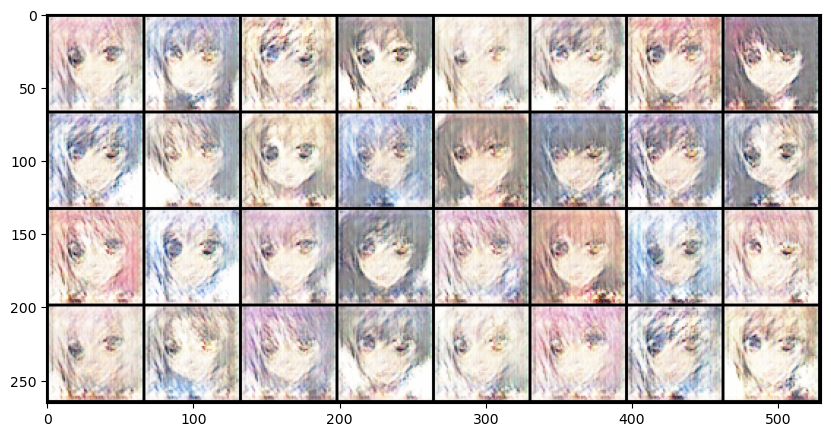

Epoch 41/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.10it/s]


Loss D:  0.6059, Loss G: 3.3377, D(x):  0.7720, D(G(z)) :  0.1294/ 0.0542


Epoch 42/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.8083, Loss G: 5.2580, D(x):  0.8991, D(G(z)) :  0.3619/ 0.0098


Epoch 43/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  1.7139, Loss G: 3.6950, D(x):  0.3182, D(G(z)) :  0.0052/ 0.0566


Epoch 44/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.08it/s]


Loss D:  0.7924, Loss G: 2.4369, D(x):  0.6325, D(G(z)) :  0.0755/ 0.1256


Epoch 45/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.6953, Loss G: 4.4502, D(x):  0.8898, D(G(z)) :  0.2897/ 0.0190


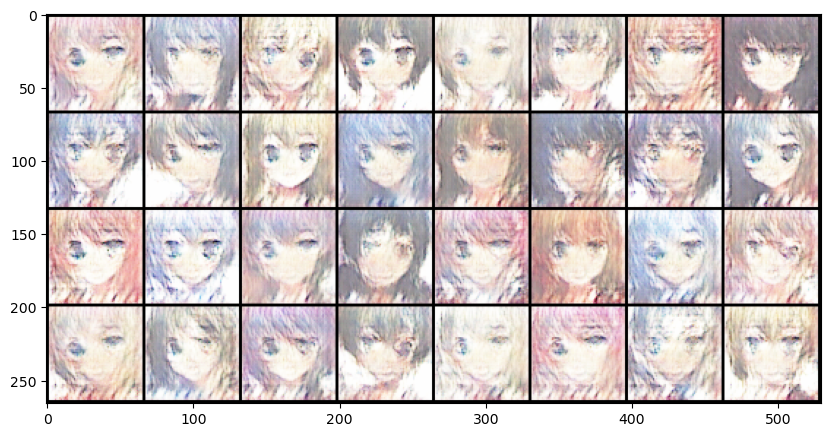

Epoch 46/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.12it/s]


Loss D:  0.8026, Loss G: 4.8363, D(x):  0.8502, D(G(z)) :  0.3363/ 0.0145


Epoch 47/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.08it/s]


Loss D:  1.1366, Loss G: 6.1514, D(x):  0.9099, D(G(z)) :  0.5108/ 0.0041


Epoch 48/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.6221, Loss G: 3.3197, D(x):  0.7305, D(G(z)) :  0.0903/ 0.0532


Epoch 49/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.05it/s]


Loss D:  0.6238, Loss G: 3.3001, D(x):  0.7086, D(G(z)) :  0.0530/ 0.0574


Epoch 50/100: 100%|█████████████████████████████████████████████████| 42/42 [00:21<00:00,  1.98it/s]


Loss D:  1.1071, Loss G: 4.9812, D(x):  0.9282, D(G(z)) :  0.4896/ 0.0115


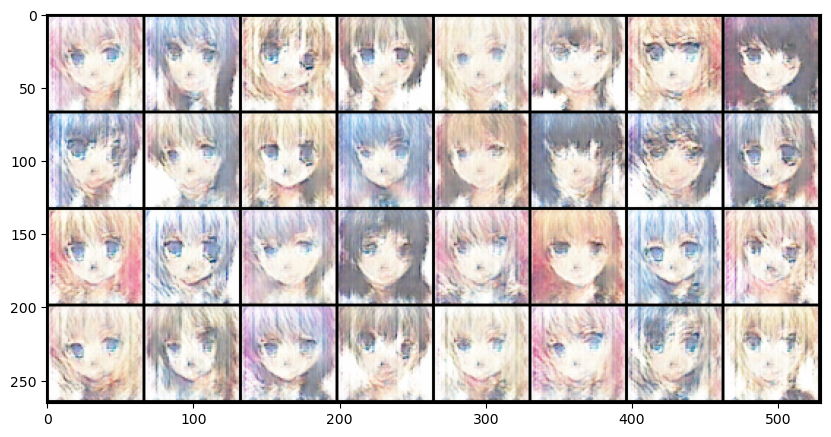

Epoch 51/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.05it/s]


Loss D:  0.6762, Loss G: 3.1852, D(x):  0.8177, D(G(z)) :  0.2394/ 0.0627


Epoch 52/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.01it/s]


Loss D:  0.8218, Loss G: 2.0130, D(x):  0.5969, D(G(z)) :  0.0651/ 0.1892


Epoch 53/100: 100%|█████████████████████████████████████████████████| 42/42 [00:21<00:00,  1.96it/s]


Loss D:  0.6748, Loss G: 3.7192, D(x):  0.8507, D(G(z)) :  0.2590/ 0.0384


Epoch 54/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.06it/s]


Loss D:  0.6044, Loss G: 2.8055, D(x):  0.7844, D(G(z)) :  0.1570/ 0.0969


Epoch 55/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.01it/s]


Loss D:  0.7611, Loss G: 2.6784, D(x):  0.6333, D(G(z)) :  0.0507/ 0.1072


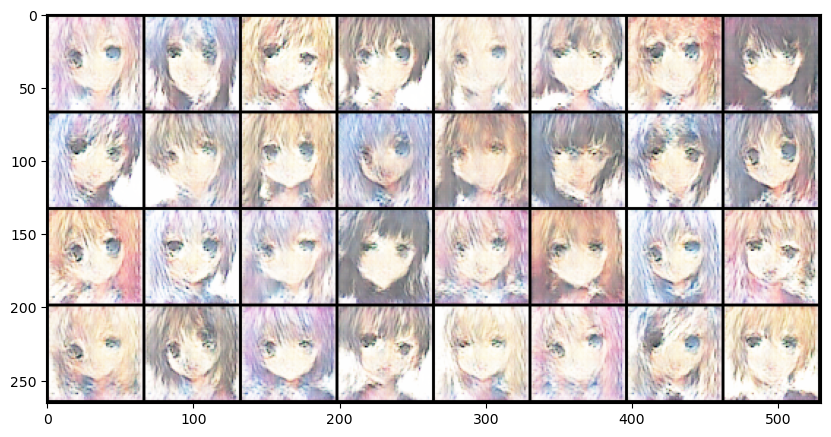

Epoch 56/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.04it/s]


Loss D:  0.5896, Loss G: 2.9218, D(x):  0.7980, D(G(z)) :  0.1464/ 0.0825


Epoch 57/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.9474, Loss G: 5.4018, D(x):  0.9161, D(G(z)) :  0.4402/ 0.0075


Epoch 58/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.7864, Loss G: 4.8187, D(x):  0.9564, D(G(z)) :  0.3648/ 0.0150


Epoch 59/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.12it/s]


Loss D:  0.6008, Loss G: 3.2619, D(x):  0.8659, D(G(z)) :  0.2118/ 0.0597


Epoch 60/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.11it/s]


Loss D:  0.7993, Loss G: 2.3443, D(x):  0.6315, D(G(z)) :  0.1056/ 0.1435


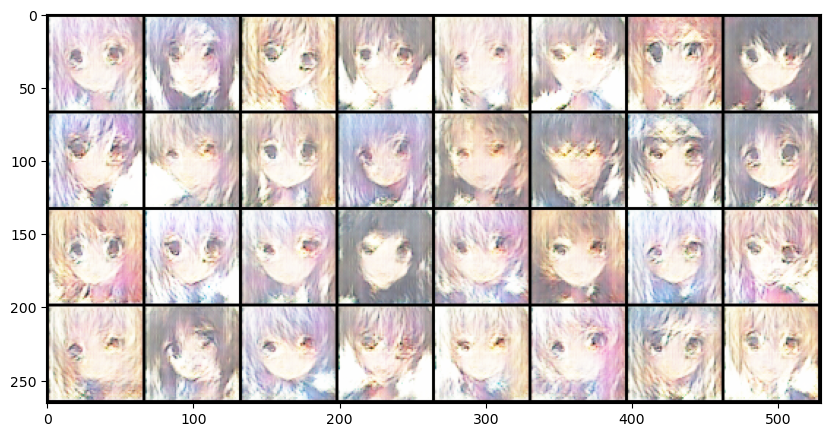

Epoch 61/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.6136, Loss G: 3.9147, D(x):  0.8365, D(G(z)) :  0.2069/ 0.0341


Epoch 62/100: 100%|█████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.09it/s]


Loss D:  0.7272, Loss G: 2.5253, D(x):  0.6941, D(G(z)) :  0.1374/ 0.1167


Epoch 63/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.19it/s]


Loss D:  0.5829, Loss G: 3.2591, D(x):  0.7500, D(G(z)) :  0.0964/ 0.0644


Epoch 64/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.25it/s]


Loss D:  0.6640, Loss G: 3.2915, D(x):  0.8289, D(G(z)) :  0.2410/ 0.0589


Epoch 65/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  0.6085, Loss G: 2.6812, D(x):  0.7667, D(G(z)) :  0.1385/ 0.1024


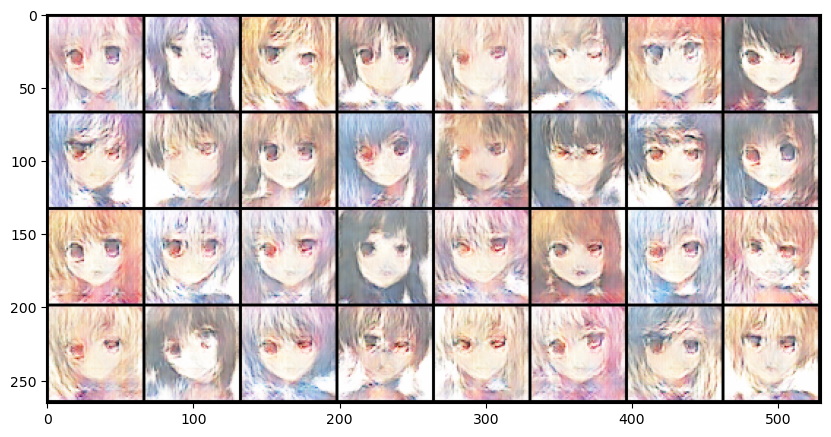

Epoch 66/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.19it/s]


Loss D:  0.8341, Loss G: 4.6696, D(x):  0.8613, D(G(z)) :  0.3627/ 0.0154


Epoch 67/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.17it/s]


Loss D:  0.7283, Loss G: 2.3363, D(x):  0.6316, D(G(z)) :  0.0409/ 0.1369


Epoch 68/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.14it/s]


Loss D:  0.8849, Loss G: 4.7985, D(x):  0.9202, D(G(z)) :  0.4111/ 0.0137


Epoch 69/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.25it/s]


Loss D:  1.2239, Loss G: 2.0033, D(x):  0.4187, D(G(z)) :  0.0222/ 0.1934


Epoch 70/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.19it/s]


Loss D:  0.9105, Loss G: 5.1177, D(x):  0.8963, D(G(z)) :  0.4213/ 0.0095


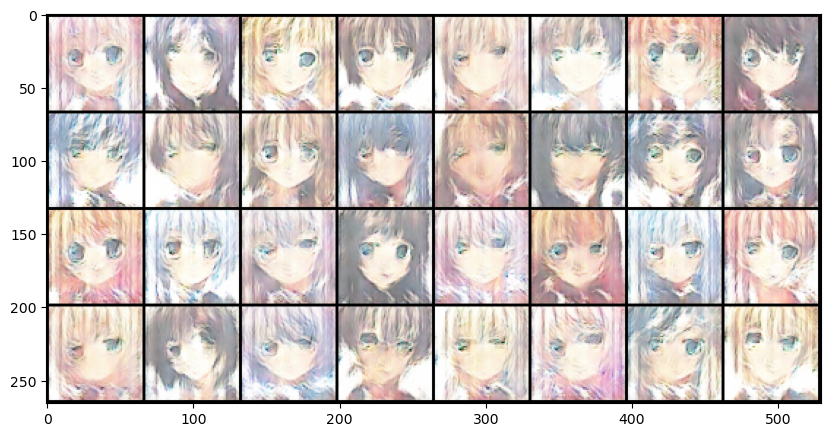

Epoch 71/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  0.6338, Loss G: 3.1151, D(x):  0.7699, D(G(z)) :  0.1587/ 0.0702


Epoch 72/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.24it/s]


Loss D:  0.7431, Loss G: 3.5812, D(x):  0.8298, D(G(z)) :  0.2947/ 0.0451


Epoch 73/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  0.7488, Loss G: 1.9936, D(x):  0.6630, D(G(z)) :  0.1371/ 0.1793


Epoch 74/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.21it/s]


Loss D:  1.2202, Loss G: 6.2838, D(x):  0.9239, D(G(z)) :  0.5619/ 0.0035


Epoch 75/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.21it/s]


Loss D:  0.6634, Loss G: 2.9231, D(x):  0.7898, D(G(z)) :  0.2200/ 0.0798


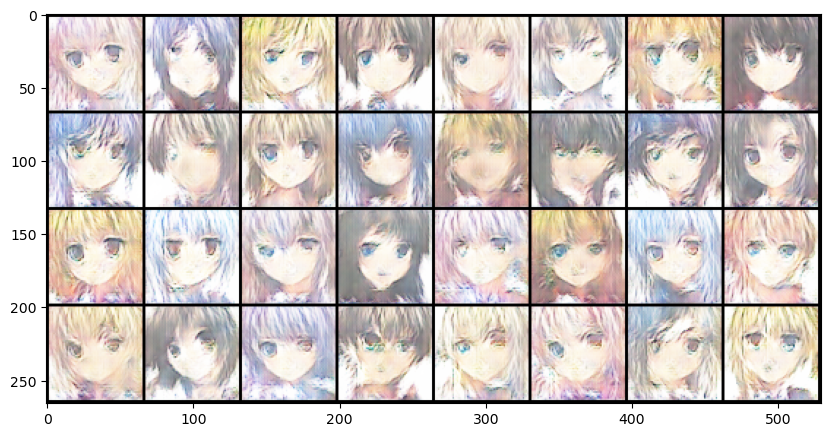

Epoch 76/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.17it/s]


Loss D:  0.6767, Loss G: 3.1513, D(x):  0.8171, D(G(z)) :  0.2365/ 0.0668


Epoch 77/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.22it/s]


Loss D:  0.7146, Loss G: 2.1382, D(x):  0.6504, D(G(z)) :  0.0742/ 0.1650


Epoch 78/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.17it/s]


Loss D:  0.9682, Loss G: 2.2546, D(x):  0.5127, D(G(z)) :  0.0304/ 0.1534


Epoch 79/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.23it/s]


Loss D:  0.6325, Loss G: 3.1972, D(x):  0.8284, D(G(z)) :  0.2243/ 0.0628


Epoch 80/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.27it/s]


Loss D:  0.7898, Loss G: 4.0636, D(x):  0.8553, D(G(z)) :  0.3345/ 0.0280


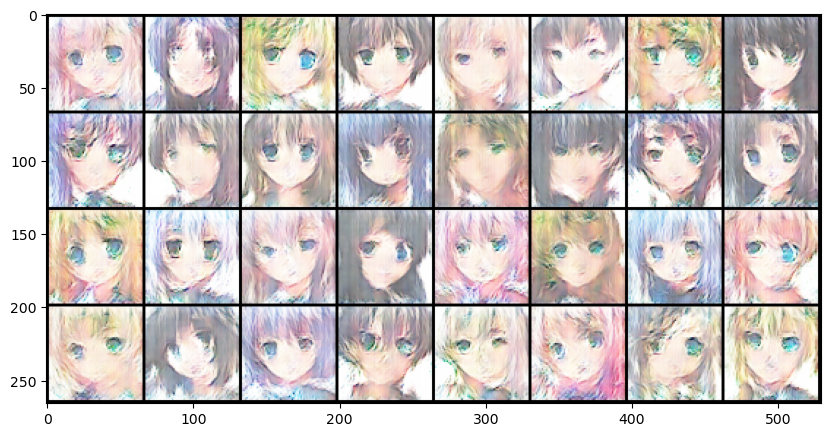

Epoch 81/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.9725, Loss G: 1.8334, D(x):  0.5055, D(G(z)) :  0.0368/ 0.2101


Epoch 82/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.25it/s]


Loss D:  0.6442, Loss G: 2.2595, D(x):  0.7136, D(G(z)) :  0.1090/ 0.1511


Epoch 83/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.21it/s]


Loss D:  0.6768, Loss G: 3.8009, D(x):  0.9232, D(G(z)) :  0.3038/ 0.0335


Epoch 84/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  0.5862, Loss G: 2.7410, D(x):  0.7488, D(G(z)) :  0.1026/ 0.0978


Epoch 85/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.24it/s]


Loss D:  0.7306, Loss G: 3.8547, D(x):  0.8639, D(G(z)) :  0.3092/ 0.0344


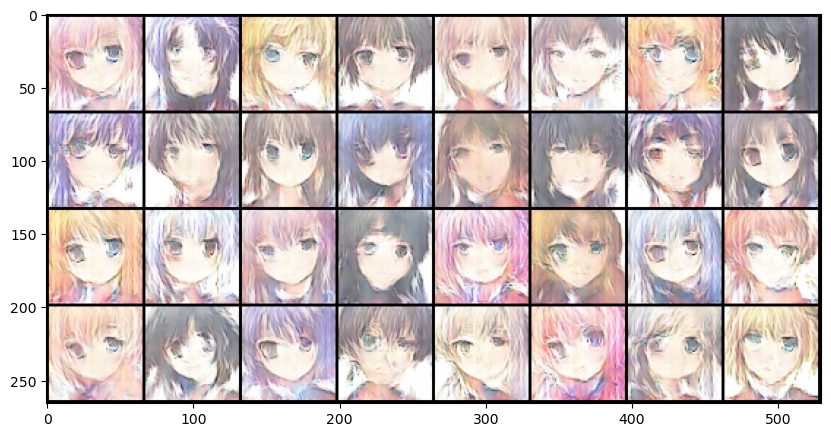

Epoch 86/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.19it/s]


Loss D:  0.6028, Loss G: 3.6303, D(x):  0.9289, D(G(z)) :  0.2468/ 0.0448


Epoch 87/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.15it/s]


Loss D:  0.8440, Loss G: 1.5669, D(x):  0.5762, D(G(z)) :  0.0677/ 0.2631


Epoch 88/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.17it/s]


Loss D:  0.7271, Loss G: 4.3321, D(x):  0.8600, D(G(z)) :  0.3034/ 0.0195


Epoch 89/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.16it/s]


Loss D:  0.7404, Loss G: 3.6897, D(x):  0.8176, D(G(z)) :  0.2892/ 0.0374


Epoch 90/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.13it/s]


Loss D:  0.7592, Loss G: 2.7301, D(x):  0.6108, D(G(z)) :  0.0513/ 0.0970


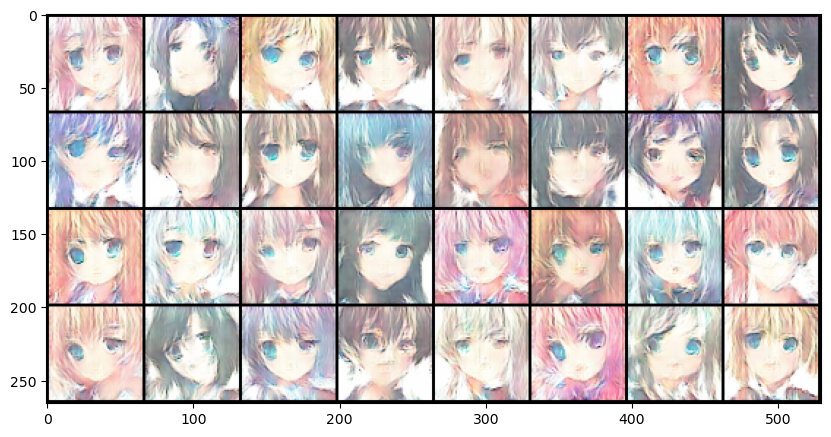

Epoch 91/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  0.6355, Loss G: 3.3479, D(x):  0.8056, D(G(z)) :  0.2089/ 0.0522


Epoch 92/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.21it/s]


Loss D:  2.2440, Loss G: 8.8834, D(x):  0.9757, D(G(z)) :  0.8115/ 0.0003


Epoch 93/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.12it/s]


Loss D:  0.7466, Loss G: 3.9641, D(x):  0.9011, D(G(z)) :  0.3419/ 0.0284


Epoch 94/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.17it/s]


Loss D:  0.7206, Loss G: 1.9246, D(x):  0.6810, D(G(z)) :  0.1416/ 0.1942


Epoch 95/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.20it/s]


Loss D:  0.6863, Loss G: 3.7280, D(x):  0.8982, D(G(z)) :  0.3057/ 0.0363


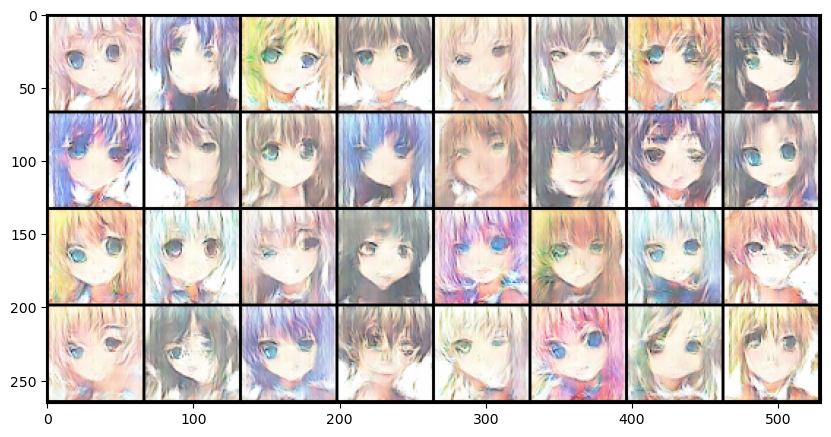

Epoch 96/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  0.6485, Loss G: 2.9065, D(x):  0.6953, D(G(z)) :  0.0902/ 0.0846


Epoch 97/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.23it/s]


Loss D:  0.9417, Loss G: 4.9441, D(x):  0.9370, D(G(z)) :  0.4599/ 0.0104


Epoch 98/100: 100%|█████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.24it/s]


Loss D:  0.6219, Loss G: 2.4134, D(x):  0.7544, D(G(z)) :  0.1455/ 0.1296


Epoch 99/100: 100%|█████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.18it/s]


Loss D:  0.6793, Loss G: 2.4356, D(x):  0.7252, D(G(z)) :  0.1643/ 0.1240


Epoch 100/100: 100%|████████████████████████████████████████████████| 42/42 [00:19<00:00,  2.20it/s]


Loss D:  0.9983, Loss G: 5.5771, D(x):  0.9326, D(G(z)) :  0.4640/ 0.0062


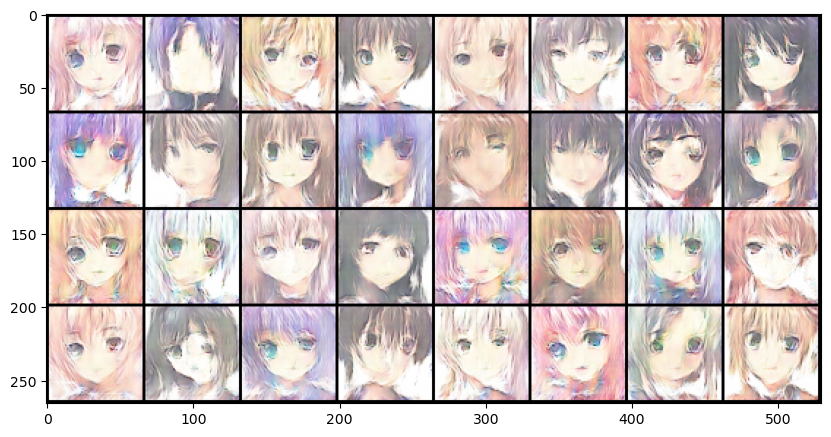

In [14]:
from torch.distributions.uniform import Uniform
from tqdm import tqdm

epochs = 100
noise_size = (batch_size, 100, 1, 1)
label_size = (batch_size, 1, 1, 1)
fixed_noise = torch.randn(noise_size, device=device)

img_list = []

for epoch in range(1, epochs + 1):
    
    gen_model.train()
    dis_model.train()
    
    for data in tqdm(train_dataloader, desc = f'Epoch {epoch}/{epochs}', ncols = 100):
        # Train Discriminator
        ## Train with real image 
        dis_model.zero_grad()
        real_img = data.to(device)
        bz = real_img.size(0)
        
        #  label smoothing
        label = Uniform(0.9, 1.0).sample(label_size).to(device)
        
        output = dis_model(real_img)
        error_real = criterion(output, label)
        error_real.backward()
        D_x = output.mean().item()
        
        ## Train with fake image 
        noise = torch.randn(noise_size, device=device)
        fake_img = gen_model(noise)
        label = Uniform(0., 0.05).sample(label_size).to(device)

        output = dis_model(fake_img.detach())
        error_fake = criterion(output, label)
        error_fake.backward()
        D_G_z1 = output.mean().item()
        error_D = error_real + error_fake
        optim_D.step()
        
        ## Train Generator
        gen_model.zero_grad()
        label = Uniform(0.95, 1.0).sample(label_size).to(device)
        output = dis_model(fake_img)
        error_G = criterion(output, label)
        error_G.backward()
        optim_G.step()
        D_G_z2 = output.mean().item()
        
    print(f'Loss D: {error_D.item(): .4f}, Loss G: {error_G.item():.4f}, D(x): {D_x: .4f}, D(G(z)) : {D_G_z1 : .4f}/{D_G_z2 : .4f}')
        
    if epoch % 5 == 0:
        with torch.no_grad():
            fake_img = gen_model(fixed_noise).detach().cpu()
        fake_img = make_grid(fake_img[:32], padding=2, normalize=True)
        img_list.append(fake_img)
        plt.figure(figsize=(10,10))
        plt.imshow(img_list[-1].permute(1,2,0))
        plt.show()

# Save 

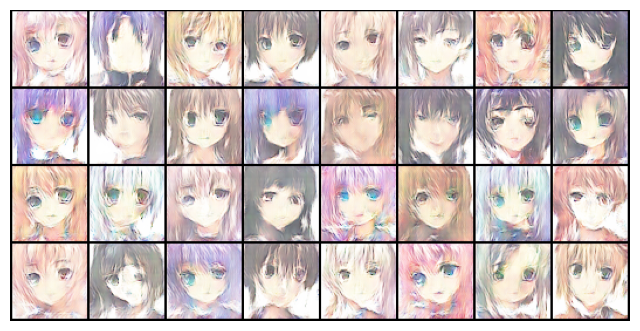

In [30]:
from matplotlib import animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
imgs = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
img_animation = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=100, blit=True)
HTML(img_animation.to_jshtml())

In [32]:
img_animation.save('dc_gan_anime_faces.gif', writer='imagemagick', fps=3)

In [35]:
torch.save(dis_model.state_dict(), 'dc_gan_discriminator_weights.pt')
torch.save(gen_model.state_dict(), 'dc_gan_generator_weights.pt')